<a href="https://colab.research.google.com/github/Anflyn/portfolio/blob/Case_11/Case11.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Загрузка библиотек

In [ ]:
!pip install pycaret

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install pandas-profiling

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from datetime import datetime, timedelta,date
import seaborn as sns
from sklearn.model_selection import train_test_split

from pycaret.classification import *
from pycaret.utils import check_metric

# EDA

In [ ]:
date_columns = ['OrderDate','ShipDate', 'StartDate', 'BirthDate', 'DateFirstPurchase']
df= pd.read_csv('/content/drive/MyDrive/Итоговая работа. АД. Крылышкина Н.И./case11.csv',parse_dates=date_columns)
df.head()

,FullName,ProductName,Margin,Profit,SalesAmount,TotalProductCost,Markup,PurchasePrice,UnitPrice,OrderQuantity,...,ABC_XYZ_Product,RFM_Product,ABC_XYZ_Customers,RFM_Customers,Churn,CustomerKey,ProductKey,SalesTerritoryKey,PromotionKey,HouseOwnerFlag
0,"Watson, Cole","Road-150 Red, 62",39.32,1406.98,3578.2700,2171.2942,64.80,1085.65,1789.1350,2,...,AZ,1133,AX,1122,No,21768,310,6,1,True
1,"Martinez, Rachael","Mountain-100 Silver, 44",43.76,1487.84,3399.9900,1912.1544,77.81,956.08,1699.9950,2,...,CZ,1111,AX,1122,Yes,28389,346,7,1,False
2,"Wright, Sydney","Mountain-100 Silver, 44",43.76,1487.84,3399.9900,1912.1544,77.81,956.08,1699.9950,2,...,CZ,1111,AX,1122,No,25863,346,1,1,True
3,"Prasad, Ruben","Road-650 Black, 62",40.90,285.95,699.0982,413.1463,69.22,206.57,349.5491,2,...,CZ,1111,CX,1111,No,14501,336,4,1,True
4,"Zhu, Christy","Mountain-100 Silver, 44",43.76,1487.84,3399.9900,1912.1544,77.81,956.08,1699.9950,2,...,CZ,1111,AX,1122,No,11003,346,9,1,False


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 58189 entries, 0 to 58188
Data columns (total 51 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   FullName              58189 non-null  object        
 1   ProductName           58189 non-null  object        
 2   Margin                58189 non-null  float64       
 3   Profit                58189 non-null  float64       
 4   SalesAmount           58189 non-null  float64       
 5   TotalProductCost      58189 non-null  float64       
 6   Markup                58189 non-null  float64       
 7   PurchasePrice         58189 non-null  float64       
 8   UnitPrice             58189 non-null  float64       
 9   OrderQuantity         58189 non-null  int64         
 10  OrderDate             58189 non-null  datetime64[ns]
 11  CustomerCountry       58189 non-null  object        
 12  ShipDate              58189 non-null  datetime64[ns]
 13  SalesOrderNumber

Датасет состоит из 58189 строк и 51 столбец.Пропусков нет.

Изменним тип столбцов 'CustomerKey','ProductKey','SalesTerritoryKey','PromotionKey' на object

In [ ]:
df[['CustomerKey','ProductKey','SalesTerritoryKey','PromotionKey']]=df[['CustomerKey','ProductKey','SalesTerritoryKey','PromotionKey']].astype(object)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 58189 entries, 0 to 58188
Data columns (total 51 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   FullName              58189 non-null  object        
 1   ProductName           58189 non-null  object        
 2   Margin                58189 non-null  float64       
 3   Profit                58189 non-null  float64       
 4   SalesAmount           58189 non-null  float64       
 5   TotalProductCost      58189 non-null  float64       
 6   Markup                58189 non-null  float64       
 7   PurchasePrice         58189 non-null  float64       
 8   UnitPrice             58189 non-null  float64       
 9   OrderQuantity         58189 non-null  int64         
 10  OrderDate             58189 non-null  datetime64[ns]
 11  CustomerCountry       58189 non-null  object        
 12  ShipDate              58189 non-null  datetime64[ns]
 13  SalesOrderNumber

In [ ]:
# поведем EDA с помощью pandas_profiling
from pandas_profiling import ProfileReport
profile = ProfileReport(df)

In [ ]:
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

**Изучениe данных:**

В датасете 27 категориальных признаков, числовых - 17, логических - 2,в фомате даты - 5.
* У большинства товаров рентабельность более 60%
* У большинства товаров наценка более 160%
* 71,5% товаров покупают по одной штуке, и по 14,3% и 14,2% по 2 и 4 соответственно
* С 2016 года резко вырос объем продаж
* Более 35% продаж приходится на США,следом идес Австралия 22,3%
* 28% продаж в подкатегории Tires and Tubes
* 59% продаж в категории Accessories
* Самый популярный цвет -черный(16,5%)
* В 74% отгрузка(подготовка) товара происходит в тот же день,в остальных случаях занимет 4 дня
* 38% прцентов приходится на товары из линейки Sport, далее идут Mountain(28%) и Road(26%)
* Лидер по продажам модель велосипеда Sport-100(10,6%)
* Основные покупатели 1963-1970 года рождения
* Распределение клиентов в браке и одиноких 55%/45%
* Соотношение мужчин и женщин примерно одинаково
* Годовой доход покупателей,которые делают покупки 40-50тыс и 60-70тыс.
* Больше всего покупок совершают клиенты не имеющие детей(28,3%)
* Уровень образования клиентов:30,2% имеют степень бакалавра, 27,5% не закончили колледж, 17,6% магистры, среднее образование также у 17%, остальные 7,7% не закончили школу
* 31.5% клиентов имеет высокие проффесиональные навыки
* У 33,7% клиентов в собственности 2 машины,следом 26,3% те,у кого 1 машина
* 35,4% клиентов работают рядом с домом(0-1 miles)
* Наибольшая доля рынка у Северной Америки - 47.5%
* Наибольшее число покупок совершили жители США, из Калифорнии(20,4%),но вместе с тем жители Лондона являются лидерами по числу покупок(на их долю приходится 2,6%)
* В категории CZ наибольшее количество товаров 83,1% всего ассортимента
* Большинство клиентов находятся в категории CX (почти 60%). Такие клиенты покупают мало и редко.
* Поле RFM_Customers - много клиентов пришли в 2016 году
* Поле Churn- почти 2% клиентов не совершали покупок в течение года(нелояльные)
* 69,1% клиентов имеют в собственности недвижимость

In [ ]:
profile.to_file(output_file="Case11.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

# Прогнозирование оттока клиентов

Возьмем те же параметры,что и в модели,созданной в Loginom

In [ ]:
churn = df[['Churn', 'MaritalStatus', 'Gender', 'NumberChildrenAtHome', 'Education', 'Occupation', 'HouseOwnerFlag', 'NumberCarsOwned', 'ABC_XYZ_Customers', 
            'ProductName', 'BirthDate', 'CommuteDistance', 'UnitPrice', 'DaysToManufacture', 'CustomerCity']]
churn

,Churn,MaritalStatus,Gender,NumberChildrenAtHome,Education,Occupation,HouseOwnerFlag,NumberCarsOwned,ABC_XYZ_Customers,ProductName,BirthDate,CommuteDistance,UnitPrice,DaysToManufacture,CustomerCity
0,No,S,M,0,Bachelors,Management,True,3,AX,"Road-150 Red, 62",1946-08-22,10+ Miles,1789.1350,4,Metchosin
1,Yes,S,F,3,High School,Manual,False,0,AX,"Mountain-100 Silver, 44",1964-12-18,0-1 Miles,1699.9950,4,Pantin
2,No,S,F,0,High School,Professional,True,3,AX,"Mountain-100 Silver, 44",1946-03-12,10+ Miles,1699.9950,4,Lebanon
3,No,M,M,0,Graduate Degree,Management,True,2,CX,"Road-650 Black, 62",1938-05-13,1-2 Miles,349.5491,4,Beverly Hills
4,No,S,F,0,Bachelors,Professional,False,1,AX,"Mountain-100 Silver, 44",1968-02-15,5-10 Miles,1699.9950,4,North Ryde
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58184,No,M,M,5,Partial High School,Management,True,4,AZ,"Touring-1000 Yellow, 46",1971-08-01,10+ Miles,2384.0700,4,North Sydney
58185,No,M,F,0,Partial College,Manual,True,1,CX,"Road-750 Black, 58",1980-08-08,2-5 Miles,539.9900,4,Rockhampton
58186,No,S,M,1,Partial High School,Clerical,True,2,CX,"Road-750 Black, 48",1948-10-01,5-10 Miles,539.9900,4,Warrnambool
58187,No,S,M,1,Partial High School,Clerical,True,2,CX,LL Road Tire,1948-10-01,5-10 Miles,21.4900,0,Warrnambool


In [ ]:
# разделим данные на тренироваочный и тестовый сеты
churn_train, churn_test = train_test_split(churn, test_size = 0.3)
print(churn_train.shape)

(40732, 15)


In [ ]:
# настройка модели
churn_price_mod=setup(churn_train, target = 'Churn', session_id=123, silent=True,normalize=True)

,Description,Value
0,session_id,123
1,Target,Churn
2,Target Type,Binary
3,Label Encoded,"No: 0, Yes: 1"
4,Original Data,"(40732, 15)"
5,Missing Values,False
6,Numeric Features,1
7,Categorical Features,12
8,Ordinal Features,False
9,High Cardinality Features,False


INFO:logs:create_model_container: 0
INFO:logs:master_model_container: 0
INFO:logs:display_container: 1
INFO:logs:Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=[],
                                      display_types=False, features_todrop=[],
                                      id_columns=[],
                                      ml_usecase='classification',
                                      numerical_features=[], target='Churn',
                                      time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value_categorical=None,
                                fill_value_numerical=None,
                                numeric_strat...
                                                  target='Churn')),
                ('P_transform', 'passthrough'), ('binn', 'passthrough'),
                ('rem_outliers', 

In [ ]:
# обучение моделей
best_model = compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
et,Extra Trees Classifier,0.9819,0.9272,0.0920,0.9659,0.1649,0.1622,0.2872,10.585
rf,Random Forest Classifier,0.9806,0.9252,0.0247,0.8750,0.0478,0.0468,0.1413,7.360
lightgbm,Light Gradient Boosting Machine,0.9804,0.9191,0.0971,0.5304,0.1610,0.1561,0.2169,0.692
lr,Logistic Regression,0.9803,0.8491,0.0424,0.5067,0.0777,0.0751,0.1404,3.157
knn,K Neighbors Classifier,0.9803,0.7830,0.0726,0.5547,0.1249,0.1208,0.1889,92.880
svm,SVM - Linear Kernel,0.9801,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.428
ridge,Ridge Classifier,0.9801,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.232
dummy,Dummy Classifier,0.9801,0.5000,0.0000,0.0000,0.0000,0.0000,0.0000,0.058
ada,Ada Boost Classifier,0.9798,0.8414,0.0142,0.2017,0.0263,0.0246,0.0491,3.783
gbc,Gradient Boosting Classifier,0.9797,0.8483,0.0496,0.4186,0.0884,0.0845,0.1382,15.401


INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                     criterion='gini', max_depth=None, max_features='auto',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.0, min_impurity_split=None,
                     min_samples_leaf=1, min_samples_split=2,
                     min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=-1,
                     oob_score=False, random_state=123, verbose=0,
                     warm_start=False)
INFO:logs:compare_models() succesfully completed......................................


Оценку модели будем оценивать по метрике AUC.Лучшей моделью показывает себя модель Extra Trees Classifier

In [ ]:
et = create_model('et')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9811,0.9217,0.0526,1.0000,0.1000,0.0982,0.2272
1,0.9821,0.9403,0.1053,1.0000,0.1905,0.1874,0.3215
2,0.9835,0.9101,0.1607,1.0000,0.2769,0.2730,0.3976
3,0.9811,0.9138,0.0536,0.7500,0.1000,0.0976,0.1973
4,0.9835,0.9580,0.1786,0.9091,0.2985,0.2940,0.3989
5,0.9818,0.9171,0.0714,1.0000,0.1333,0.1311,0.2648
6,0.9811,0.9205,0.0526,1.0000,0.1000,0.0982,0.2272
7,0.9825,0.9347,0.1228,1.0000,0.2188,0.2153,0.3473
8,0.9814,0.9234,0.0702,1.0000,0.1311,0.1289,0.2624


INFO:logs:create_model_container: 15
INFO:logs:master_model_container: 15
INFO:logs:display_container: 3
INFO:logs:ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                     criterion='gini', max_depth=None, max_features='auto',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.0, min_impurity_split=None,
                     min_samples_leaf=1, min_samples_split=2,
                     min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=-1,
                     oob_score=False, random_state=123, verbose=0,
                     warm_start=False)
INFO:logs:create_model() succesfully completed......................................


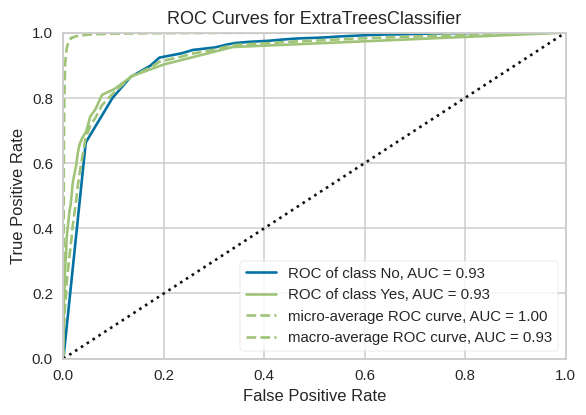

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(et, scale=1.5)

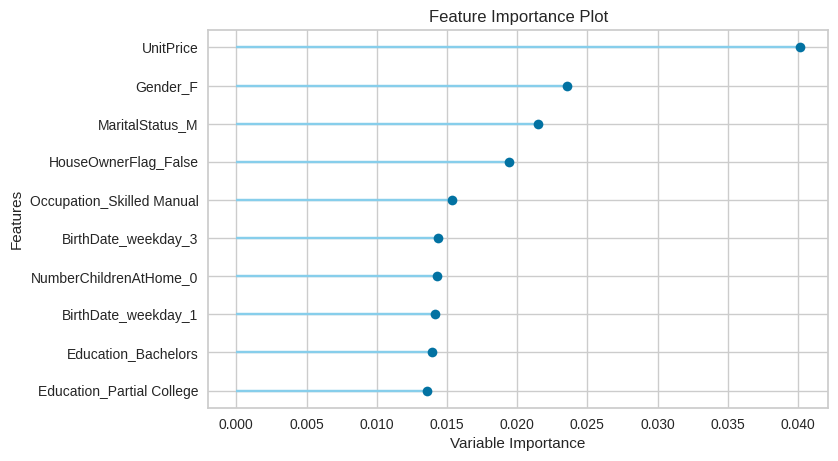

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
#Посмотрим какие критерии модель считает важными
plot_model(et, plot = 'feature')

Модель считает главным фыктором оттока цену продажи.

In [ ]:
#Настроим гиперпараметры
tuned_et = tune_model(et)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9800,0.5,0.0,0.0,0.0,0.0,0.0
1,0.9800,0.5,0.0,0.0,0.0,0.0,0.0
2,0.9804,0.5,0.0,0.0,0.0,0.0,0.0
3,0.9804,0.5,0.0,0.0,0.0,0.0,0.0
4,0.9804,0.5,0.0,0.0,0.0,0.0,0.0
5,0.9804,0.5,0.0,0.0,0.0,0.0,0.0
6,0.9800,0.5,0.0,0.0,0.0,0.0,0.0
7,0.9800,0.5,0.0,0.0,0.0,0.0,0.0
8,0.9800,0.5,0.0,0.0,0.0,0.0,0.0


INFO:logs:create_model_container: 17
INFO:logs:master_model_container: 17
INFO:logs:display_container: 5
INFO:logs:ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight={},
                     criterion='gini', max_depth=3, max_features='sqrt',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.1, min_impurity_split=None,
                     min_samples_leaf=4, min_samples_split=9,
                     min_weight_fraction_leaf=0.0, n_estimators=70, n_jobs=-1,
                     oob_score=False, random_state=123, verbose=0,
                     warm_start=False)
INFO:logs:tune_model() succesfully completed......................................


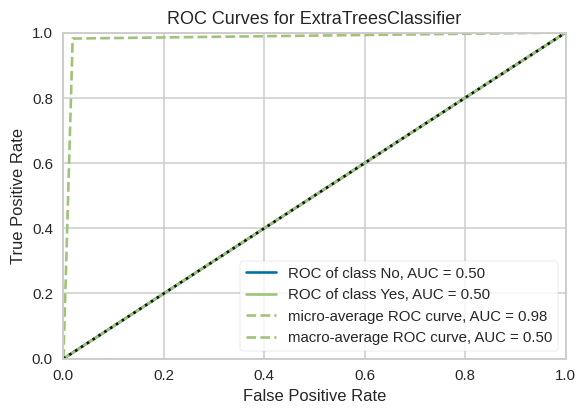

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(tuned_et, scale=1.5)

После настройки гиперпараметров показатели ухудшились,будем использовать не тюнингованную модель.

In [ ]:
evaluate_model(et)

INFO:logs:Initializing evaluate_model()
INFO:logs:evaluate_model(estimator=ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                     criterion='gini', max_depth=None, max_features='auto',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.0, min_impurity_split=None,
                     min_samples_leaf=1, min_samples_split=2,
                     min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=-1,
                     oob_score=False, random_state=123, verbose=0,
                     warm_start=False), fold=None, fit_kwargs=None, plot_kwargs=None, feature_name=None, groups=None, use_train_data=False)


interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

In [ ]:
predict_model(et)

INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                     criterion='gini', max_depth=None, max_features='auto',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.0, min_impurity_split=None,
                     min_samples_leaf=1, min_samples_split=2,
                     min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=-1,
                     oob_score=False, random_state=123, verbose=0,
                     warm_start=False), probability_threshold=None, encoded_labels=False, drift_report=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None, drift_kwargs=None)
INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Extra Trees Classifier,0.9836,0.9296,0.1156,0.963,0.2063,0.2032,0.3306


,UnitPrice,MaritalStatus_M,Gender_F,NumberChildrenAtHome_0,NumberChildrenAtHome_1,NumberChildrenAtHome_2,NumberChildrenAtHome_3,NumberChildrenAtHome_4,NumberChildrenAtHome_5,Education_Bachelors,...,BirthDate_weekday_2,BirthDate_weekday_3,BirthDate_weekday_4,BirthDate_weekday_5,BirthDate_weekday_6,BirthDate_is_month_end_1,BirthDate_is_month_start_1,Churn,Label,Score
0,-0.340587,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,No,No,0.98
1,-0.489825,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,No,No,1.00
2,2.415193,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,No,No,0.99
3,-0.459979,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,No,No,1.00
4,0.142905,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,No,No,0.79
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12215,-0.486834,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,No,No,1.00
12216,-0.491308,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,No,No,1.00
12217,-0.495794,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,No,No,1.00
12218,-0.495794,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,No,No,1.00


In [ ]:
final_et = finalize_model(et)
print(final_et)

INFO:logs:Initializing finalize_model()
INFO:logs:finalize_model(estimator=ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                     criterion='gini', max_depth=None, max_features='auto',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.0, min_impurity_split=None,
                     min_samples_leaf=1, min_samples_split=2,
                     min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=-1,
                     oob_score=False, random_state=123, verbose=0,
                     warm_start=False), fit_kwargs=None, groups=None, model_only=True, display=None, experiment_custom_tags=None, return_train_score=False)
INFO:logs:Finalizing ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                     criterion='gini', max_depth=None, max_features='auto',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.0, mi

ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                     criterion='gini', max_depth=None, max_features='auto',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.0, min_impurity_split=None,
                     min_samples_leaf=1, min_samples_split=2,
                     min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=-1,
                     oob_score=False, random_state=123, verbose=0,
                     warm_start=False)


In [ ]:
# прогноз модели
unseen_predictions_et = predict_model(final_et, data=churn_test)
unseen_predictions_et.head()

INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                     criterion='gini', max_depth=None, max_features='auto',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.0, min_impurity_split=None,
                     min_samples_leaf=1, min_samples_split=2,
                     min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=-1,
                     oob_score=False, random_state=123, verbose=0,
                     warm_start=False), probability_threshold=None, encoded_labels=False, drift_report=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None, drift_kwargs=None)
INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Extra Trees Classifier,0,0.9546,0,0,0,0,0


,Churn,MaritalStatus,Gender,NumberChildrenAtHome,Education,Occupation,HouseOwnerFlag,NumberCarsOwned,ABC_XYZ_Customers,ProductName,BirthDate,CommuteDistance,UnitPrice,DaysToManufacture,CustomerCity,Label,Score
46910,No,S,F,4,Bachelors,Professional,True,0,BX,HL Mountain Tire,1967-12-22,1-2 Miles,35.0000,0,Newcastle,No,1.0
37840,No,S,M,0,Partial College,Clerical,True,1,CX,Patch Kit/8 Patches,1975-01-12,2-5 Miles,2.2900,0,Courbevoie,No,1.0
23762,No,M,M,4,Partial College,Professional,False,3,CZ,Road Tire Tube,1961-01-16,5-10 Miles,3.9900,0,Cliffside,No,1.0
51306,No,M,F,2,Partial College,Clerical,False,2,CX,Bike Wash - Dissolver,1964-09-06,0-1 Miles,1.9875,0,Dresden,No,1.0
16041,No,S,M,0,Partial College,Skilled Manual,True,1,CX,LL Road Tire,1957-03-19,5-10 Miles,21.4900,0,Hawthorne,No,1.0


Метрики модели


In [ ]:
check_metric(actual=unseen_predictions_et['Churn'],prediction=unseen_predictions_et['Label'], metric='AUC')

0.5712

In [ ]:
check_metric(actual=unseen_predictions_et['Churn'],prediction=unseen_predictions_et['Label'], metric='Accuracy')

0.9844

In [ ]:
#Сохраним модель
save_model(final_et,'final_et_churn_29_10_2022')

INFO:logs:Initializing save_model()
INFO:logs:save_model(model=ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                     criterion='gini', max_depth=None, max_features='auto',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.0, min_impurity_split=None,
                     min_samples_leaf=1, min_samples_split=2,
                     min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=-1,
                     oob_score=False, random_state=123, verbose=0,
                     warm_start=False), model_name=final_et_churn_29_10_2022, prep_pipe_=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=[],
                                      display_types=False, features_todrop=[],
                                      id_columns=[],
                                      ml_usecase='classification',
                                      numerical

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=[],
                                       display_types=False, features_todrop=[],
                                       id_columns=[],
                                       ml_usecase='classification',
                                       numerical_features=[], target='Churn',
                                       time_features=[])),
                 ('imputer',
                  Simple_Imputer(categorical_strategy='not_available',
                                 fill_value_categorical=None,
                                 fill_value_numerical=None,
                                 numeric_strat...
                  ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0,
                                       class_weight=None, criterion='gini',
                                       max_depth=None, max_features='auto',
                                       max_leaf_nod

# Временные ряды Tableau

In [ ]:
%%HTML
<div class='tableauPlaceholder' id='viz1667073332071' style='position: relative'><noscript><a href='#'><img alt='Story 1 ' src='https:&#47;&#47;public.tableau.com&#47;static&#47;images&#47;Ca&#47;Case11_16670733093850&#47;Story1&#47;1_rss.png' style='border: none' /></a></noscript><object class='tableauViz'  style='display:none;'><param name='host_url' value='https%3A%2F%2Fpublic.tableau.com%2F' /> <param name='embed_code_version' value='3' /> <param name='site_root' value='' /><param name='name' value='Case11_16670733093850&#47;Story1' /><param name='tabs' value='no' /><param name='toolbar' value='yes' /><param name='static_image' value='https:&#47;&#47;public.tableau.com&#47;static&#47;images&#47;Ca&#47;Case11_16670733093850&#47;Story1&#47;1.png' /> <param name='animate_transition' value='yes' /><param name='display_static_image' value='yes' /><param name='display_spinner' value='yes' /><param name='display_overlay' value='yes' /><param name='display_count' value='yes' /><param name='language' value='en-US' /><param name='filter' value='publish=yes' /></object></div>                <script type='text/javascript'>                    var divElement = document.getElementById('viz1667073332071');                    var vizElement = divElement.getElementsByTagName('object')[0];                    vizElement.style.width='1016px';vizElement.style.height='991px';                    var scriptElement = document.createElement('script');                    scriptElement.src = 'https://public.tableau.com/javascripts/api/viz_v1.js';                    vizElement.parentNode.insertBefore(scriptElement, vizElement);                </script>